In [1]:
!date

Thu May 23 19:53:10 PDT 2019


# RNA Velocity on 120k Mouse Retinal Cells

In [1]:
import pandas as pd
import anndata
import scanpy as sc
import numpy as np
import scipy as scp
import sklearn
import matplotlib.pyplot as plt
import matplotlib
import sys
import loompy
import scipy.optimize
import velocyto as vcy
import scvelo as scv
import glob
import pickle

from collections import Counter
from sklearn.decomposition import PCA
from scipy.spatial.distance import pdist, squareform
from IPython.core.display import display, HTML

matplotlib.rcParams.update({'font.size': 22})
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
files = glob.glob("/home/sina/projects/bus/velocity/data/mouse_retinal_dev_GSE118614/kallisto*")

In [3]:
%%time
f = files[0]
sample = "_".join(f.split("/")[8].split("_")[1::])
t = "".join(sample.split("_")[0])

spliced = f + "/gene_count/spliced/"
unspliced = f + "/gene_count/unspliced/"

s = scp.io.mmread(spliced + "s.mtx")
u = scp.io.mmread(unspliced + "u.mtx")

s_bcs = pd.read_csv(spliced + "s.barcodes.txt", header=None)
s_bcs["sample"] = sample
s_bcs["time"] = t
s_bcs["barcode"] = s_bcs[0]
s_bcs.index = s_bcs["sample"] + "." + s_bcs["barcode"]
del s_bcs[0]
 
u_bcs = pd.read_csv(unspliced + "u.barcodes.txt", header=None)
u_bcs["sample"] = sample
u_bcs["time"] = t
u_bcs["barcode"] = u_bcs[0]
u_bcs.index = u_bcs["sample"] + "." + u_bcs["barcode"]
del u_bcs[0]

CPU times: user 28.4 s, sys: 599 ms, total: 29 s
Wall time: 28.9 s


In [4]:
%%time
for f in files[1::]:
    sample = "_".join(f.split("/")[8].split("_")[1::])
    print(sample)
    t = "".join(sample.split("_")[0])
    
    spliced = f + "/gene_count/spliced/"
    unspliced = f + "/gene_count/unspliced/"
    
    s_tmp = scp.io.mmread(spliced + "s.mtx")
    u_tmp = scp.io.mmread(unspliced + "u.mtx")
    
    s = scp.sparse.vstack([s, s_tmp])
    u = scp.sparse.vstack([u, u_tmp])
    
    s_bcs_tmp = pd.read_csv(spliced + "s.barcodes.txt", header=None)
    s_bcs_tmp["sample"] = sample
    s_bcs_tmp["time"] = t
    s_bcs_tmp["barcode"] = s_bcs_tmp[0]
    s_bcs_tmp.index = s_bcs_tmp["sample"] + "." + s_bcs_tmp["barcode"]
    del s_bcs_tmp[0]
    
    s_bcs = s_bcs.append(s_bcs_tmp)
    
    u_bcs_tmp = pd.read_csv(unspliced + "u.barcodes.txt", header=None)
    u_bcs_tmp["sample"] = sample
    u_bcs_tmp["time"] = t
    u_bcs_tmp["barcode"] = u_bcs_tmp[0]
    u_bcs_tmp.index = u_bcs_tmp["sample"] + "." + u_bcs_tmp["barcode"]
    del u_bcs_tmp[0]
    
    u_bcs = u_bcs.append(u_bcs_tmp)

E16
P8_rep2
E18_rep2
P14
P0
P8_rep1
P2_rep2
E14_rep2
E11
E12
P2_rep3
E14_rep1
E18_rep3
CPU times: user 9min 45s, sys: 41.6 s, total: 10min 27s
Wall time: 12min 47s


In [5]:
genes = pd.read_csv(unspliced + "u.genes.txt", header=None)
genes.index = genes[0].str.slice(0, 18)
genes.index.names = ["gene_id"]
del genes[0]

In [6]:
s = scp.sparse.csr_matrix(s)
u = scp.sparse.csr_matrix(u)

In [7]:
them_bcs = pd.read_csv("./GSE118614_barcodes.tsv", header=0, sep="\t")
them_bcs["_barcode"] = them_bcs["barcode"].str.slice(0, -2)

In [8]:
them_bcs.tail()

,barcode,sample,age,num_genes_expressed,Total_mRNAs,umap_cluster,umap_coord1,umap_coord2,umap_coord3,used_for_pseudotime,umap2_CellType,_barcode
P8_rep2.TTTGTCACAACCGCCA.1,P8_rep2.TTTGTCACAACCGCCA-1,P8_rep2,P8,406,525,107,1.441268,5.090573,1.679778,True,Bipolar Cells,P8_rep2.TTTGTCACAACCGCCA
P8_rep2.TTTGTCACAGGATTGG.1,P8_rep2.TTTGTCACAGGATTGG-1,P8_rep2,P8,440,553,84,-0.933211,6.210865,0.584979,True,Rods,P8_rep2.TTTGTCACAGGATTGG
P8_rep2.TTTGTCAGTCGGCTCA.1,P8_rep2.TTTGTCAGTCGGCTCA-1,P8_rep2,P8,550,721,107,1.745962,5.059008,1.633069,False,Bipolar Cells,P8_rep2.TTTGTCAGTCGGCTCA
P8_rep2.TTTGTCATCGCTTAGA.1,P8_rep2.TTTGTCATCGCTTAGA-1,P8_rep2,P8,579,748,107,1.188123,5.120153,1.959507,True,Bipolar Cells,P8_rep2.TTTGTCATCGCTTAGA
P8_rep2.TTTGTCATCTTAGCCC.1,P8_rep2.TTTGTCATCTTAGCCC-1,P8_rep2,P8,508,702,98,-0.493532,6.491569,0.216649,True,Rods,P8_rep2.TTTGTCATCTTAGCCC


In [9]:
them_bcs.age.value_counts()

E14    26944
E18    23011
P2     17963
P8     11727
P0      9925
E11     9364
P14     8103
P5      6756
E16     5401
E12     1610
Name: age, dtype: int64

In [10]:
them_genes = pd.read_csv("./GSE118614_genes.tsv", header=0, sep="\t")

In [11]:
them_genes.head()

,id,gene_short_name,num_cells_expressed
ENSMUSG00000051951,ENSMUSG00000051951,Xkr4,253
ENSMUSG00000089699,ENSMUSG00000089699,Gm1992,4
ENSMUSG00000102343,ENSMUSG00000102343,Gm37381,58
ENSMUSG00000025900,ENSMUSG00000025900,Rp1,11816
ENSMUSG00000109048,ENSMUSG00000109048,Rp1,0


In [12]:
them_bcs.index = them_bcs["_barcode"]

In [13]:
s_bcs["sample"] = s_bcs["sample"].replace("E12", "E12_rep1")
u_bcs["sample"] = u_bcs["sample"].replace("E12", "E12_rep1")

In [14]:
s_bcs.head()

,sample,time,barcode
P5.AAACCTGAGAAACCGC,P5,P5,AAACCTGAGAAACCGC
P5.AAACCTGAGAAACGAG,P5,P5,AAACCTGAGAAACGAG
P5.AAACCTGAGAAACGCC,P5,P5,AAACCTGAGAAACGCC
P5.AAACCTGAGAACAATC,P5,P5,AAACCTGAGAACAATC
P5.AAACCTGAGAACTGTA,P5,P5,AAACCTGAGAACTGTA


In [15]:
s_bcs.index = s_bcs["sample"].astype(str) +  "." + s_bcs["barcode"].astype(str)
u_bcs.index = u_bcs["sample"].astype(str) +  "." + u_bcs["barcode"].astype(str)

In [16]:
%%time
s_bcs["umap_cluster"]        = pd.Series(s_bcs.index.map(them_bcs["umap_cluster"]), index = s_bcs.index)
s_bcs["umap_coord1"]         = pd.Series(s_bcs.index.map(them_bcs["umap_coord1"]), index = s_bcs.index)
s_bcs["umap_coord2"]         = pd.Series(s_bcs.index.map(them_bcs["umap_coord2"]), index = s_bcs.index)
s_bcs["umap_coord3"]         = pd.Series(s_bcs.index.map(them_bcs["umap_coord3"]), index = s_bcs.index)
s_bcs["used_for_pseudotime"] = pd.Series(s_bcs.index.map(them_bcs["used_for_pseudotime"]), index = s_bcs.index)
s_bcs["umap2_CellType"]      = pd.Series(s_bcs.index.map(them_bcs["umap2_CellType"]), index = s_bcs.index)

CPU times: user 3.21 s, sys: 33.4 ms, total: 3.24 s
Wall time: 3.24 s


In [17]:
%%time
u_bcs["umap_cluster"]        = pd.Series(u_bcs.index.map(them_bcs["umap_cluster"]), index = u_bcs.index)
u_bcs["umap_coord1"]         = pd.Series(u_bcs.index.map(them_bcs["umap_coord1"]), index = u_bcs.index)
u_bcs["umap_coord2"]         = pd.Series(u_bcs.index.map(them_bcs["umap_coord2"]), index = u_bcs.index)
u_bcs["umap_coord3"]         = pd.Series(u_bcs.index.map(them_bcs["umap_coord3"]), index = u_bcs.index)
u_bcs["used_for_pseudotime"] = pd.Series(u_bcs.index.map(them_bcs["used_for_pseudotime"]), index = u_bcs.index)
u_bcs["umap2_CellType"]      = pd.Series(u_bcs.index.map(them_bcs["umap2_CellType"]), index = u_bcs.index)

CPU times: user 2.04 s, sys: 30 ms, total: 2.07 s
Wall time: 2.07 s


In [18]:
s_bcs[s_bcs["time"]=="E12"]["umap_coord1"].nunique()

1610

# Making AnnData objects

In [19]:
%%time
sadata = anndata.AnnData(X=s, obs=s_bcs, var=genes)
uadata = anndata.AnnData(X=u, obs=u_bcs, var=genes)

CPU times: user 3.6 s, sys: 1.26 s, total: 4.86 s
Wall time: 4.85 s


In [20]:
%%time
sadata.write("spliced_adata.h5ad")
uadata.write("unspliced_adata.h5ad")

... storing 'sample' as categorical
... storing 'time' as categorical
... storing 'barcode' as categorical
... storing 'used_for_pseudotime' as categorical
... storing 'umap2_CellType' as categorical
... storing 'sample' as categorical
... storing 'time' as categorical
... storing 'barcode' as categorical
... storing 'used_for_pseudotime' as categorical
... storing 'umap2_CellType' as categorical


CPU times: user 41.8 s, sys: 6.54 s, total: 48.3 s
Wall time: 52 s


## Filtering uadata and sadata by bcs given

In [21]:
print(uadata)
print(sadata)

AnnData object with n_obs × n_vars = 2570136 × 54838 
    obs: 'sample', 'time', 'barcode', 'umap_cluster', 'umap_coord1', 'umap_coord2', 'umap_coord3', 'used_for_pseudotime', 'umap2_CellType'
AnnData object with n_obs × n_vars = 3560581 × 54838 
    obs: 'sample', 'time', 'barcode', 'umap_cluster', 'umap_coord1', 'umap_coord2', 'umap_coord3', 'used_for_pseudotime', 'umap2_CellType'


In [22]:
%%time
sadata = sadata[sadata.obs.index.isin(them_bcs["_barcode"]),:]
uadata = uadata[uadata.obs.index.isin(them_bcs["_barcode"]),:]

CPU times: user 3.18 s, sys: 2.28 s, total: 5.47 s
Wall time: 5.47 s


In [23]:
%%time
sadata = sadata[sadata.obs.index.isin(uadata.obs.index),:]
uadata = uadata[uadata.obs.index.isin(sadata.obs.index),:]

CPU times: user 3.94 s, sys: 4.31 s, total: 8.24 s
Wall time: 8.25 s


In [24]:
%%time
sadata = sadata[:,sadata.var.index.isin(them_genes.index)]
uadata = uadata[:,uadata.var.index.isin(them_genes.index)]

CPU times: user 5.49 s, sys: 5.06 s, total: 10.6 s
Wall time: 10.6 s


In [25]:
print(sadata)
print(uadata)

View of AnnData object with n_obs × n_vars = 113917 × 27740 
    obs: 'sample', 'time', 'barcode', 'umap_cluster', 'umap_coord1', 'umap_coord2', 'umap_coord3', 'used_for_pseudotime', 'umap2_CellType'
View of AnnData object with n_obs × n_vars = 113917 × 27740 
    obs: 'sample', 'time', 'barcode', 'umap_cluster', 'umap_coord1', 'umap_coord2', 'umap_coord3', 'used_for_pseudotime', 'umap2_CellType'


In [26]:
adata = anndata.AnnData(X=sadata.X, obs=sadata.obs, var=sadata.var)

In [27]:
adata.layers["spliced"] = sadata.X
adata.layers["unspliced"] = uadata.X

In [28]:
adata

AnnData object with n_obs × n_vars = 113917 × 27740 
    obs: 'sample', 'time', 'barcode', 'umap_cluster', 'umap_coord1', 'umap_coord2', 'umap_coord3', 'used_for_pseudotime', 'umap2_CellType'
    layers: 'spliced', 'unspliced'

In [29]:
%%time
adata.write("combined_adata.h5ad")

CPU times: user 1.7 s, sys: 4.99 s, total: 6.69 s
Wall time: 9.78 s


# Analysis

In [30]:
adata = anndata.read("combined_adata.h5ad")

In [31]:
adata.obs["time"].value_counts()

E14    26944
E18    23011
P8     11727
P2     11079
P0      9925
E11     9364
P14     8103
P5      6756
E16     5398
E12     1610
Name: time, dtype: int64

In [32]:
adata.obs["sample"].value_counts()

E14_rep1    16154
E18_rep3    11597
E18_rep2    11414
E14_rep2    10790
P0           9925
P2_rep3      9893
E11          9364
P8_rep1      8252
P14          8103
P5           6756
E16          5398
P8_rep2      3475
E12_rep1     1610
P2_rep2      1186
Name: sample, dtype: int64

In [33]:
adata.obs['umap2_CellType'].value_counts()

Early RPCs                                                28742
Late RPCs                                                 22217
Rods                                                      14635
Neurogenic Cells                                           8561
Doublets                                                   8017
Amacrine Cells                                             7012
Retinal Ganglion Cells                                     6232
Photoreceptor Precursors                                   5373
Bipolar Cells                                              3733
Cones                                                      3490
Muller Glia                                                2636
Horizontal Cells                                           1631
RPE/Margin/Periocular Mesenchyme/Lens Epithelial Cells      836
Red Blood Cells                                             802
Name: umap2_CellType, dtype: int64

## Filtering

In [34]:
sc.pp.filter_genes(adata, min_cells=0)
sc.pp.filter_cells(adata, min_genes=1)

In [35]:
scv.utils.show_proportions(adata)

Abundance of ['spliced', 'unspliced']: [0.62 0.38]


In [36]:
adata

AnnData object with n_obs × n_vars = 113909 × 27740 
    obs: 'sample', 'time', 'barcode', 'umap_cluster', 'umap_coord1', 'umap_coord2', 'umap_coord3', 'used_for_pseudotime', 'umap2_CellType', 'n_genes'
    var: 'n_cells'
    layers: 'spliced', 'unspliced'

In [37]:
scv.pp.neighbors(adata, n_pcs=50, n_neighbors=40)

computing neighbors
    finished (0:03:34.70) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix


In [38]:
%%time
scv.pp.filter_genes(adata, min_counts=3, min_counts_u=2)
scv.pp.normalize_per_cell(adata)
scv.pp.filter_genes_dispersion(adata, n_top_genes=5000)
scv.pp.log1p(adata)

Filtered out 8196 genes that are detected in less than 3 counts (spliced).
Filtered out 1607 genes that are detected in less than 2 counts (unspliced).
CPU times: user 20.1 s, sys: 15.5 s, total: 35.6 s
Wall time: 35.7 s


In [39]:
scv.pp.neighbors(adata, n_pcs=50, n_neighbors=40)

computing neighbors
    finished (0:01:24.22) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix


In [40]:
%%time
scv.pp.moments(adata, n_pcs=50, n_neighbors=40)

computing neighbors
    finished (0:01:25.11) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing moments based on connectivities
    finished (0:00:35.89) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
CPU times: user 22min 27s, sys: 1min 29s, total: 23min 56s
Wall time: 2min 1s


In [41]:
scv.tl.velocity(adata)
scv.tl.velocity_graph(adata)

computing velocities
    finished (0:00:36.45) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:01:00.04) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing velocity graph
    finished (0:37:10.02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [42]:
adata

AnnData object with n_obs × n_vars = 113909 × 5000 
    obs: 'sample', 'time', 'barcode', 'umap_cluster', 'umap_coord1', 'umap_coord2', 'umap_coord3', 'used_for_pseudotime', 'umap2_CellType', 'n_genes', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts'
    var: 'n_cells', 'means', 'dispersions', 'dispersions_norm', 'velocity_gamma', 'velocity_r2', 'velocity_genes'
    uns: 'pca', 'neighbors', 'velocity_graph', 'velocity_graph_neg'
    obsm: 'X_pca'
    varm: 'PCs'
    layers: 'spliced', 'unspliced', 'Ms', 'Mu', 'velocity'

In [43]:
adata.obsm["X_umap"] = np.hstack((adata.obs["umap_coord2"].values.reshape(adata.shape[0], 1), adata.obs["umap_coord3"].values.reshape(adata.shape[0], 1)))

In [44]:
adata.obsm["X_umap"]

array([[ 2.28441497,  1.59395857],
       [ 2.08830129,  5.10443518],
       [ 5.04804788,  0.31593722],
       ...,
       [-0.09630223,  3.91537829],
       [-2.45817088, -0.6352708 ],
       [ 1.12386384,  5.16445597]])

In [45]:
scv.tl.velocity_embedding(adata, basis='umap')

computing velocity embedding
    finished (0:00:24.27) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


<Figure size 432x288 with 0 Axes>

In [46]:
sc.tl.pca(adata)

In [47]:
scv.tl.velocity_embedding(adata, basis='pca')

computing velocity embedding
    finished (0:00:06.40) --> added
    'velocity_pca', embedded velocity vectors (adata.obsm)


<Figure size 432x288 with 0 Axes>

saving figure to file ./figures/velocity_umap_umap_celltypes.pdf


<Figure size 432x288 with 0 Axes>

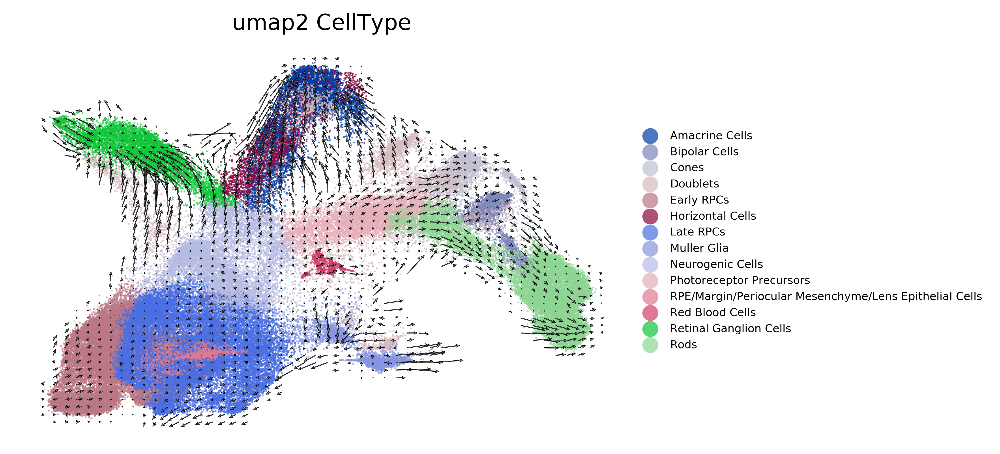

In [95]:
scv.pl.velocity_embedding_grid(adata, basis='umap', scale=0.4, dpi=300, color="umap2_CellType", legend_loc="right margin", legend_fontsize=6, alpha=0.7, save="umap_celltypes.pdf")

saving figure to file ./figures/velocity_umap_umap_time.pdf


<Figure size 432x288 with 0 Axes>

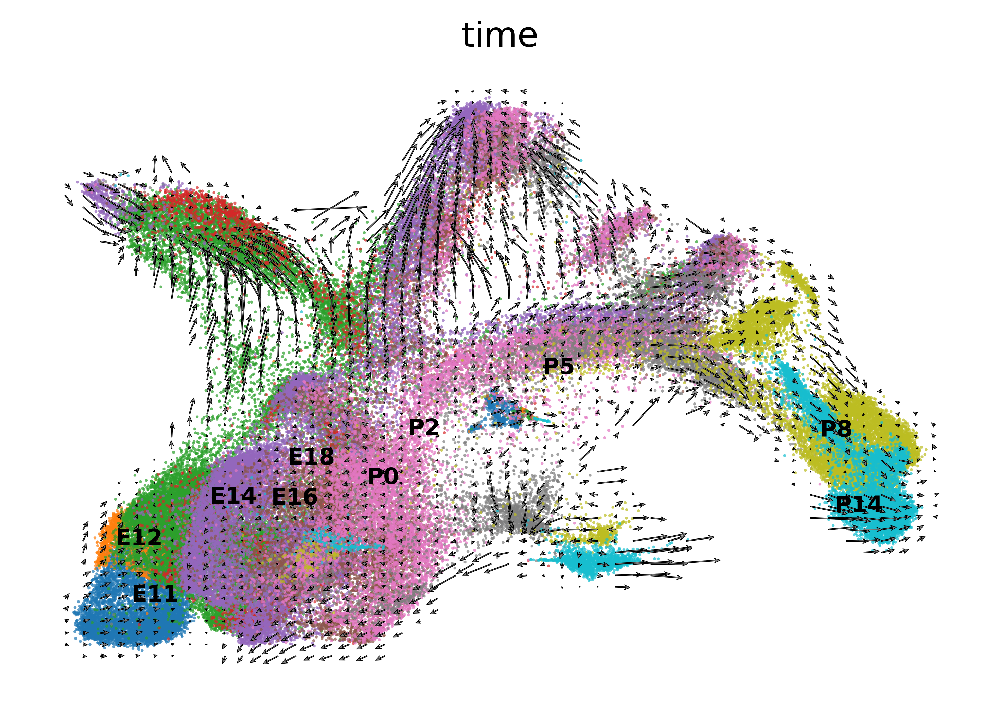

In [94]:
scv.pl.velocity_embedding_grid(adata, basis='umap', scale=0.4, dpi=300, color="time", legend_loc="on data", legend_fontsize=8, alpha=0.7, save="umap_time.pdf")

In [65]:
adata.var["gene"] = adata.var.index.map(them_genes["gene_short_name"])

In [84]:
adata.var = adata.var.reset_index()

AnnData expects string indices for some functionality, but your first two indices are: RangeIndex(start=0, stop=2, step=1). 


In [85]:
adata.var.index = adata.var["gene"]

In [72]:
interest = ["Crx", "Nrl", "Otx2", "Pax6", "Rbpms" ,"Rlbp1"]

saving figure to file ./figures/velocity_velocity.png


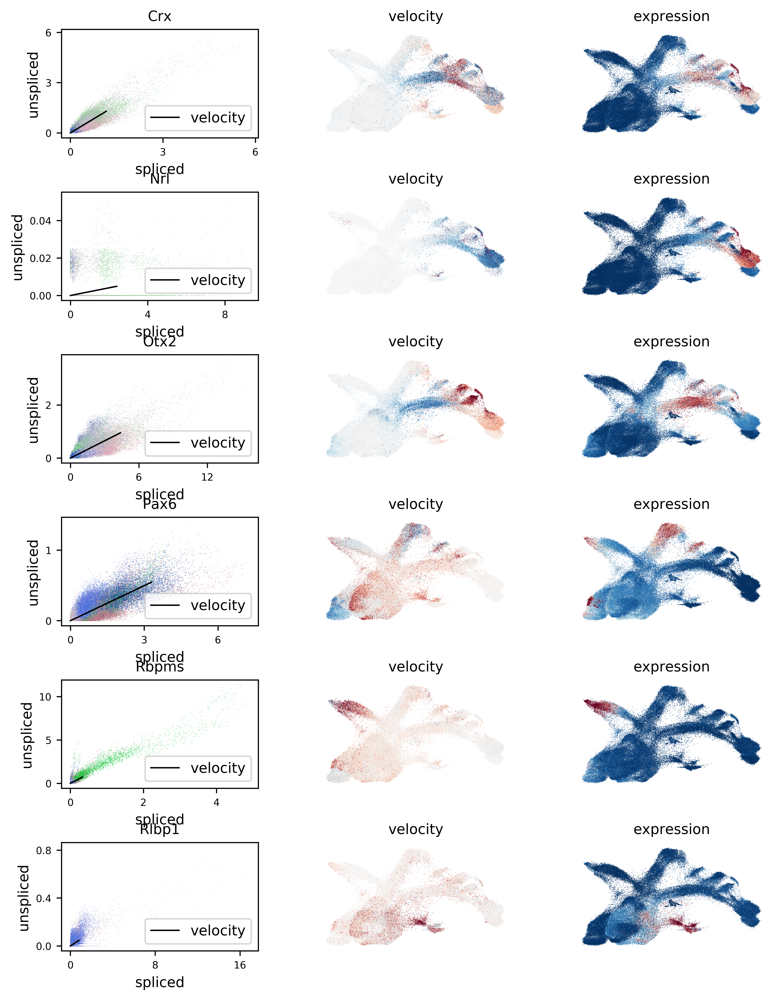

In [106]:
scv.pl.velocity(adata, basis='umap', var_names=interest, dpi=300, color="umap2_CellType", size=1, save="velocity.png")